## Training a model to detect tire screws

Prepare the customized dataset: reorganize the dataset folder (.json file) into COCO format.

In [1]:
from labelme2coco import convert
labelme_folder = "/home/wzhmiasanmia/hi_workspace/wheel_bolt_recognition/images"
export_dir = "/home/wzhmiasanmia/hi_workspace/wheel_bolt_recognition/data/"
train_split_rate = 0.8
convert(labelme_folder, export_dir, train_split_rate)

There are 94 listed files in folder images.


Converting labelme annotations to COCO format: 100%|██████████| 94/94 [00:00<00:00, 581.61it/s]


from images create data and split them into train and val dataset

In [3]:
from split_data import copy_images

train_json_file_path = "/home/wzhmiasanmia/hi_workspace/wheel_bolt_recognition/data/train.json"
val_json_file_path = "/home/wzhmiasanmia/hi_workspace/wheel_bolt_recognition/data/val.json"
image_source_directory = "/home/wzhmiasanmia/hi_workspace/wheel_bolt_recognition/images"
train_directory = "/home/wzhmiasanmia/hi_workspace/wheel_bolt_recognition/data/train"
val_directory = "/home/wzhmiasanmia/hi_workspace/wheel_bolt_recognition/data/val"

copy_images(train_json_file_path, image_source_directory, train_directory)
copy_images(val_json_file_path, image_source_directory, val_directory)

Copied IMG_3855_crop.jpg to /home/wzhmiasanmia/hi_workspace/wheel_bolt_recognition/data/train
Copied IMG_3857_rotate_90.jpg to /home/wzhmiasanmia/hi_workspace/wheel_bolt_recognition/data/train
Copied IMG_3860_brightness.jpg to /home/wzhmiasanmia/hi_workspace/wheel_bolt_recognition/data/train
Copied IMG_3856_gaussian_noise.jpg to /home/wzhmiasanmia/hi_workspace/wheel_bolt_recognition/data/train
Copied IMG_3856_crop.jpg to /home/wzhmiasanmia/hi_workspace/wheel_bolt_recognition/data/train
Copied IMG_3860_sharpen.jpg to /home/wzhmiasanmia/hi_workspace/wheel_bolt_recognition/data/train
Copied IMG_3861.jpg to /home/wzhmiasanmia/hi_workspace/wheel_bolt_recognition/data/train
Copied IMG_3866_brightness.jpg to /home/wzhmiasanmia/hi_workspace/wheel_bolt_recognition/data/train
Copied IMG_3858.jpg to /home/wzhmiasanmia/hi_workspace/wheel_bolt_recognition/data/train
Copied IMG_3866.jpg to /home/wzhmiasanmia/hi_workspace/wheel_bolt_recognition/data/train
Copied IMG_3865_gaussian_noise.jpg to /home/w

prepare a config

remember to change root dir at config file(rtmdet_tiny_1xb4-20e_tire.py)

In [6]:
!python tools/train.py configs/rtmdet_tiny_1xb4-20e_tire.py

12/04 10:48:19 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: linux
    Python: 3.8.18 (default, Sep 11 2023, 13:40:15) [GCC 11.2.0]
    CUDA available: True
    numpy_random_seed: 1141116962
    GPU 0: NVIDIA GeForce RTX 3060 Ti
    CUDA_HOME: /path/to/your/cuda
    GCC: gcc (Ubuntu 9.4.0-1ubuntu1~20.04.2) 9.4.0
    PyTorch: 2.1.1+cu121
    PyTorch compiling details: PyTorch built with:
  - GCC 9.3
  - C++ Version: 201703
  - Intel(R) oneAPI Math Kernel Library Version 2023.1-Product Build 20230303 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v3.1.1 (Git Hash 64f6bcbcbab628e96f33a62c3e975f8535a7bde4)
  - OpenMP 201511 (a.k.a. OpenMP 4.5)
  - LAPACK is enabled (usually provided by MKL)
  - NNPACK is enabled
  - CPU capability usage: AVX2
  - CUDA Runtime 12.1
  - NVCC architecture flags: -gencode;arch=compute_50,code=sm_50;-gencode;arch=compute_60,code=sm_60;-gencode;arch=compute_70,code=sm_70;-g

tensor board

In [7]:
# load tensorboard in colab
%load_ext tensorboard

# see curves in tensorboard
%tensorboard --logdir ./work_dirs

fit the model

In [1]:
from mmdet.apis import DetInferencer
import glob

# Choose to use a config
config = 'configs/rtmdet_tiny_1xb4-20e_tire.py'
# Setup a checkpoint file to load
checkpoint = glob.glob('./work_dirs/rtmdet_tiny_1xb4-20e_tire/best_coco*.pth')[0]

# Set the device to be used for evaluation
device = 'cuda:0'

# Initialize the DetInferencer
inferencer = DetInferencer(config, checkpoint, device)

Loads checkpoint by local backend from path: ./work_dirs/rtmdet_tiny_1xb4-20e_tire/best_coco_bbox_mAP_epoch_25.pth
12/04 15:07:59 - mmengine - WARNING - Failed to search registry with scope "mmdet" in the "function" registry tree. As a workaround, the current "function" registry in "mmengine" is used to build instance. This may cause unexpected failure when running the built modules. Please check whether "mmdet" is a correct scope, or whether the registry is initialized.


/home/wzhmiasanmia/miniconda3/envs/openmmlab/lib/python3.8/site-packages/mmengine/visualization/visualizer.py:196: UserWarning: Failed to add <class 'mmengine.visualization.vis_backend.LocalVisBackend'>, please provide the `save_dir` argument.
  warnings.warn(f'Failed to add {vis_backend.__class__}, '
/home/wzhmiasanmia/miniconda3/envs/openmmlab/lib/python3.8/site-packages/mmengine/visualization/visualizer.py:196: UserWarning: Failed to add <class 'mmengine.visualization.vis_backend.TensorboardVisBackend'>, please provide the `save_dir` argument.
  warnings.warn(f'Failed to add {vis_backend.__class__}, '


output result

In [2]:
import os

# Use the detector to do inference
img_folder = 'data/test/'
for img in os.listdir(img_folder):
    img_path = os.path.join(img_folder, img)
    inferencer(img_path, show=False, out_dir='outputs/', no_save_pred=False)

/home/wzhmiasanmia/miniconda3/envs/openmmlab/lib/python3.8/site-packages/rich/live.py:231: UserWarning: install 
"ipywidgets" for Jupyter support
  warnings.warn('install "ipywidgets" for Jupyter support')

/home/wzhmiasanmia/miniconda3/envs/openmmlab/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: 
torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at
../aten/src/ATen/native/TensorShape.cpp:3526.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]

Show

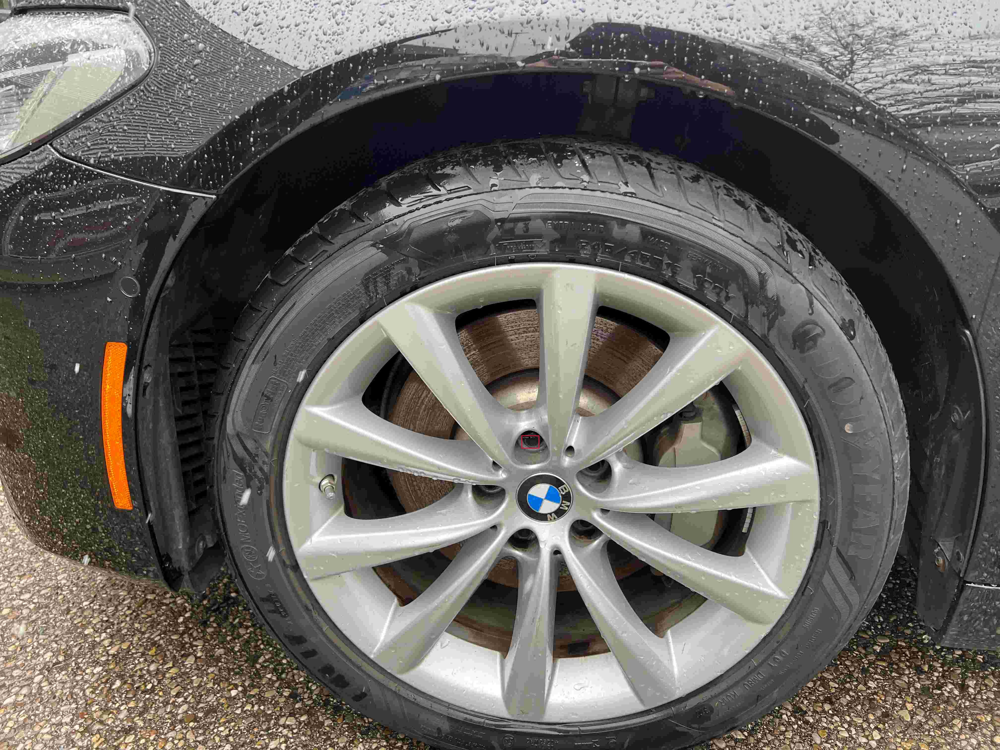

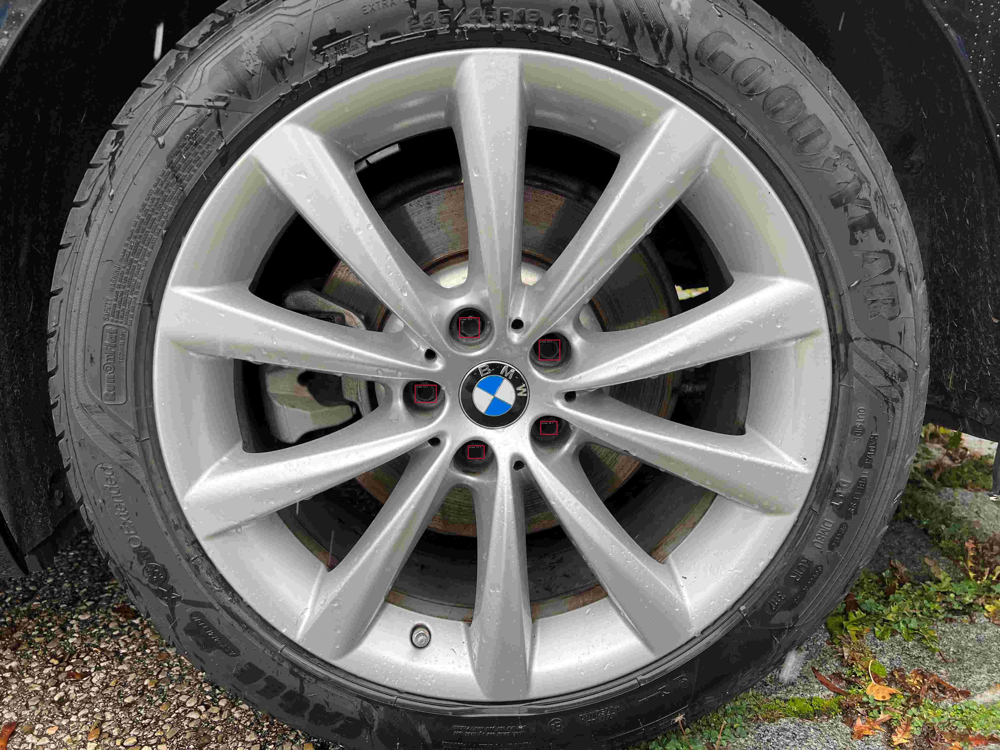

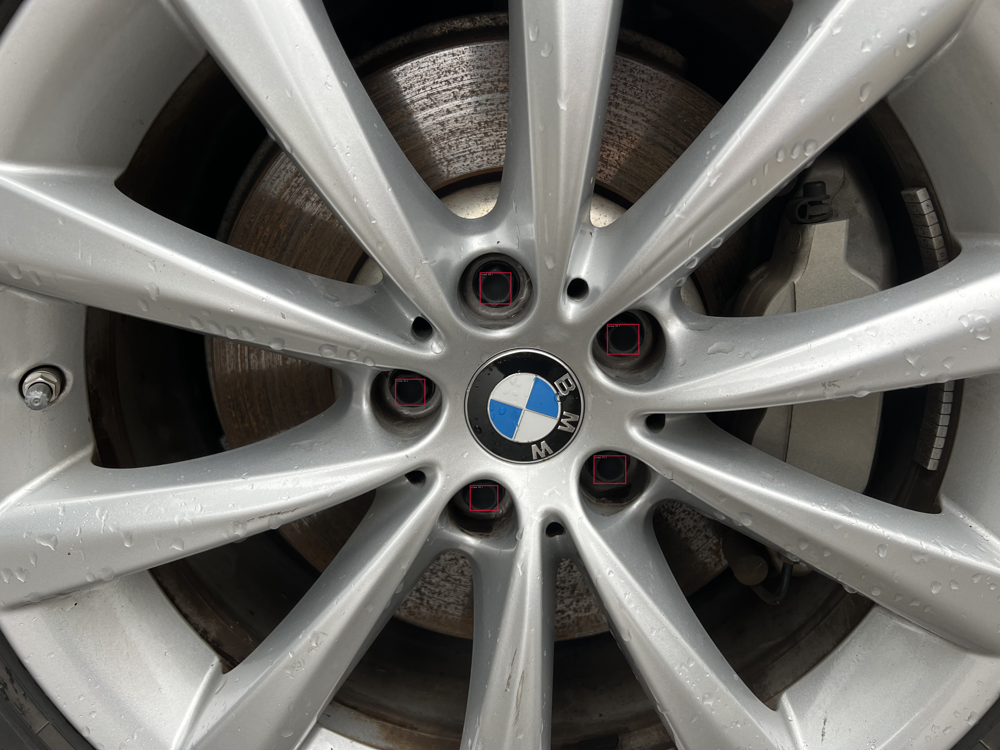

In [6]:
from PIL import Image
import os
vis_folder = "outputs/vis/"
for img_name in os.listdir(vis_folder):
    img_path = os.path.join(vis_folder, img_name)
    img = Image.open(img_path)
    img.show()